In [1]:
import datashader as ds
import xarray as xr
import numpy as np
from datashader.transfer_functions import shade
from datashader.transfer_functions import stack

## Input xarray data

C:\Users\mdo\Anaconda3\envs\xrspatial\lib\importlib\_bootstrap.py:219: RuntimeWarning: numpy.ufunc size changed, may indicate binary incompatibility. Expected 192 from C header, got 216 from PyObject
  return f(*args, **kwds)


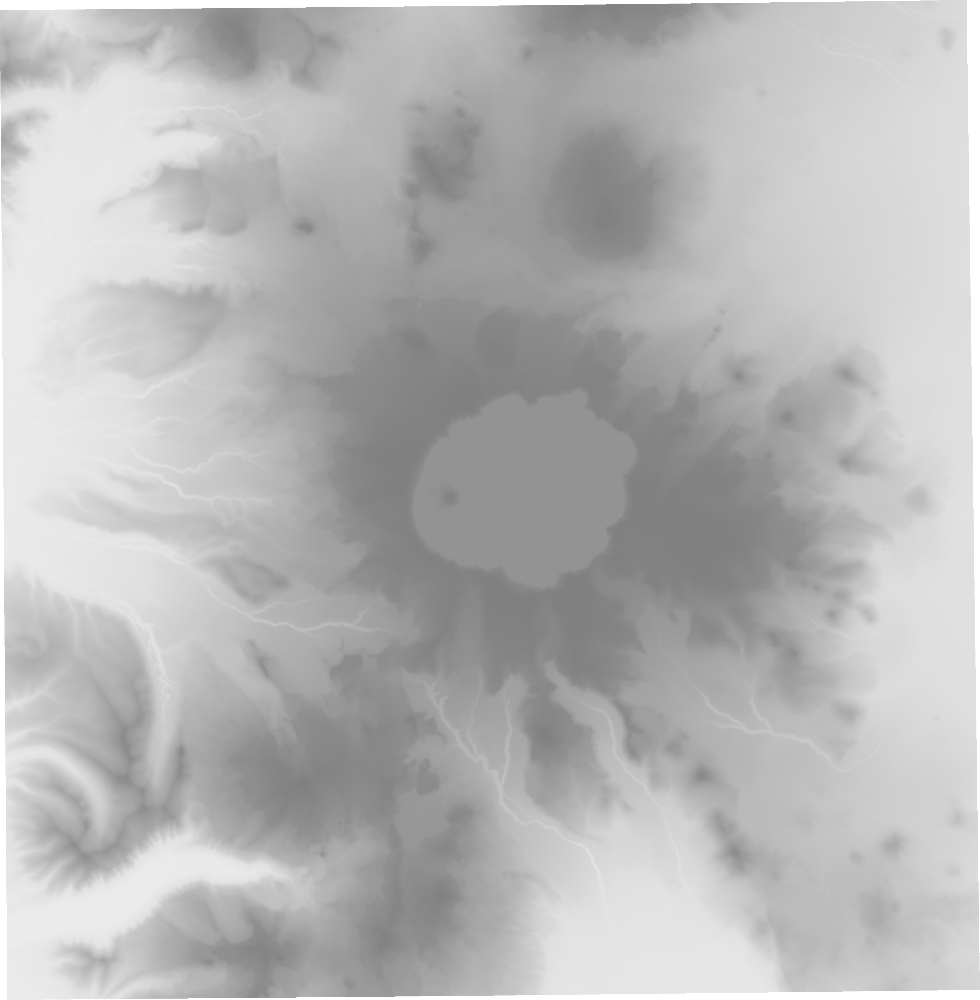

In [2]:
da = xr.open_rasterio('test_data/crater-lake-dem.tif')
# replace nodata value by np.nan
da.data[da.data == -32767.] = np.nan
# squeeze to 2 dims of ('x', 'y')
da = da.squeeze()
shade(da, cmap='gray')

## 1. `slope`

In [3]:
# from xrspatial import slope

# slope by xrspatial
xrspatial_slope = slope(da)

# slope by QGIS
qgis_slope = xr.open_rasterio('test_data/crater-lake-dem-slope-planar-degrees-z-1.tif')
# squeeze to 2 dims of ('x', 'y')
qgis_slope = qgis_slope.squeeze()
# qgis_slope.data
qgis_slope.data[qgis_slope.data == -3.4028234663852886e+38] = np.nan

`xrspatial` excludes border edges (first and last rows/columns) from calculation, their slope values are 0s.
    1. Thus, we excludes border edges from comparision.
    2. Check nan cells
    3. Check non-nan cells

In [4]:
# exclude border edges
nan_xrspatial = np.where(np.isnan(xrspatial_slope.data[1:-1, 1:-1]))
nan_qgis = np.where(np.isnan(qgis_slope.data[1:-1, 1:-1]))

# positions of nan cells
nan_xrspatial_idx = set([i for i in zip(nan_xrspatial[0] + 1, nan_xrspatial[1] + 1)])
nan_qgis_idx = set([i for i in zip(nan_qgis[0] + 1, nan_qgis[1] + 1)])

print('number of nans returned by xrspatial              ', len(nan_xrspatial_idx))
print('number of nans returned by QGIS                   ', len(nan_qgis_idx))
print('number of nans by QGIS that also nans by xrspatial', len(nan_xrspatial_idx) - len(nan_xrspatial_idx - nan_qgis_idx))

number of nans returned by xrspatial               354711
number of nans returned by QGIS                    354539
number of nans by QGIS that also nans by xrspatial 354539


- `xrspatial` returns `nan` if there is a `nan` in the 3 x 3 filter
- `QGIS` handles `nan` somehow differently ???

In [5]:
diff_nans_idx = nan_xrspatial_idx - nan_qgis_idx
num_diff_nans = len(diff_nans_idx)

nan_filters = 0
for i, j in diff_nans_idx:
    filter = da.data[i-1:i+2, j-1:j+2]
    if np.count_nonzero(np.isnan(filter)) > 0:
        nan_filters += 1
nan_filters, num_diff_nans

(172, 172)

In [6]:
# compare non-nan cells
diff = xrspatial_slope.data - qgis_slope.data
num_diff_non_nans = np.count_nonzero(diff) - np.count_nonzero(np.isnan(diff))
num_diff_non_nans

0

In [7]:
diff_rate = (num_diff_nans + num_diff_non_nans) / ((da.shape[0] - 2) * (da.shape[1] - 2) + 4)
diff_rate

9.925667713228301e-06

#### Visualize result by `xrspatial`

C:\Users\mdo\Anaconda3\envs\xrspatial\lib\site-packages\ipykernel_launcher.py:1: RuntimeWarning: invalid value encountered in greater
  """Entry point for launching an IPython kernel.
C:\Users\mdo\Anaconda3\envs\xrspatial\lib\site-packages\ipykernel_launcher.py:1: RuntimeWarning: invalid value encountered in less
  """Entry point for launching an IPython kernel.


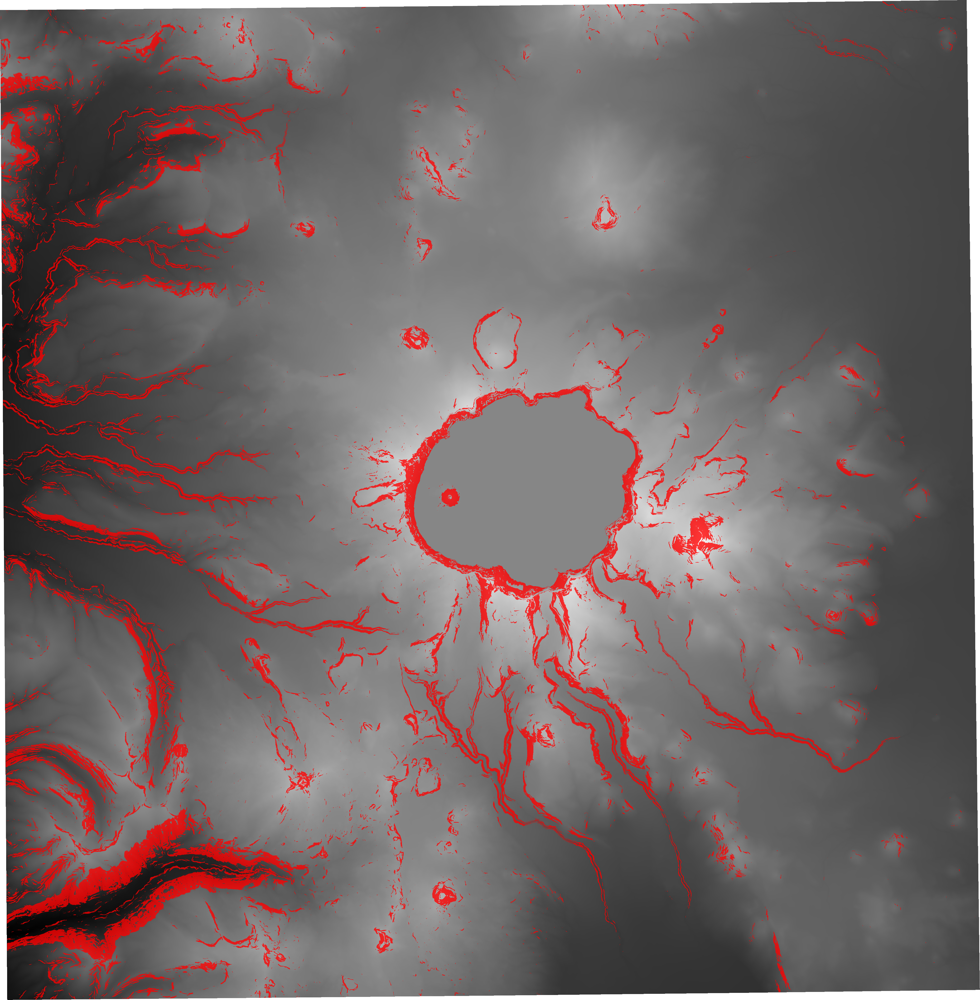

In [8]:
xrspatial_slope.data = np.where(np.logical_and(xrspatial_slope.data > 25, xrspatial_slope.data < 50), 1, np.nan)

stack(shade(da,              cmap=['black', 'white'], how='linear'),
      shade(xrspatial_slope, cmap='red',              how='linear', alpha=200))

#### Visualize result by `QGIS`

C:\Users\mdo\Anaconda3\envs\xrspatial\lib\site-packages\ipykernel_launcher.py:1: RuntimeWarning: invalid value encountered in greater
  """Entry point for launching an IPython kernel.
C:\Users\mdo\Anaconda3\envs\xrspatial\lib\site-packages\ipykernel_launcher.py:1: RuntimeWarning: invalid value encountered in less
  """Entry point for launching an IPython kernel.


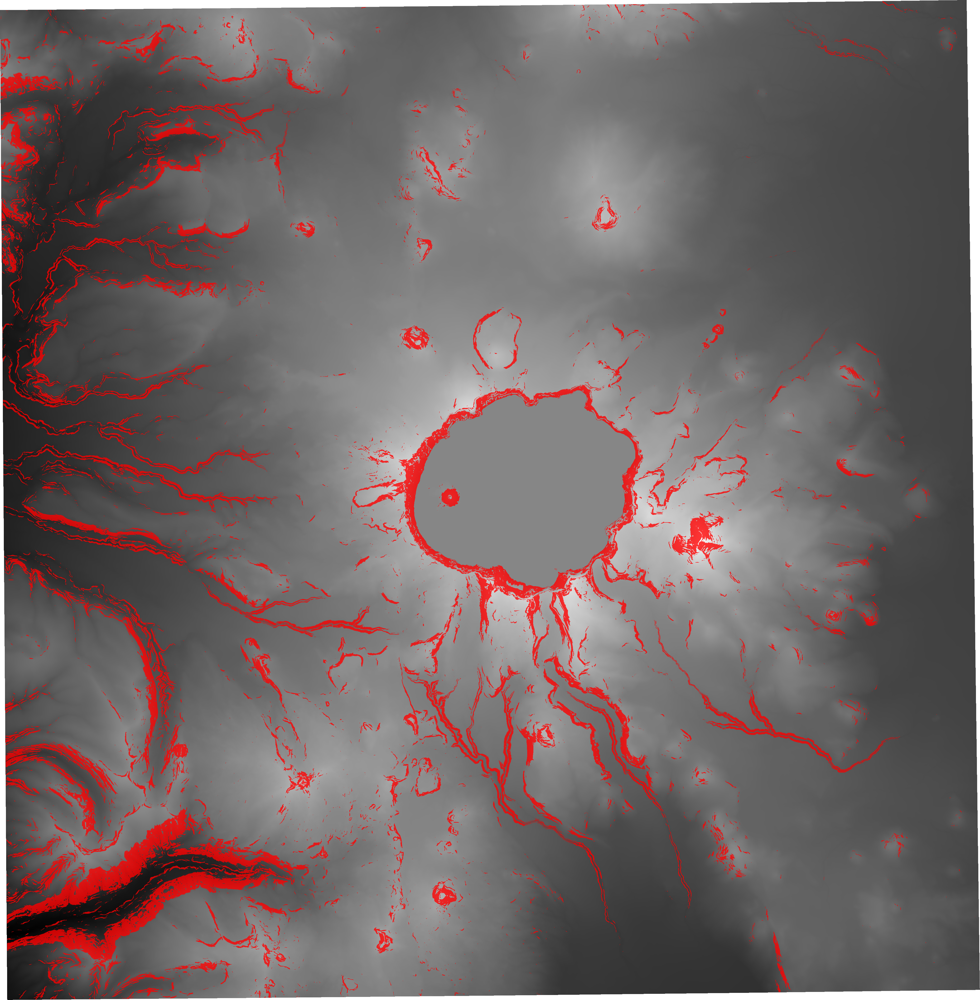

In [9]:
qgis_slope.data = np.where(np.logical_and(qgis_slope.data > 25, qgis_slope.data < 50), 1, np.nan)

stack(shade(da,         cmap=['black', 'white'], how='linear'),
      shade(qgis_slope, cmap='red',              how='linear', alpha=200))